In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image

import requests
import accelerate
import torch
import time
from diffusers import StableDiffusionInstructPix2PixPipeline, \
                      EulerAncestralDiscreteScheduler

%matplotlib inline

# Разметка данных #

### Посмотрим на датасет ###

In [2]:
img_paths = []

with open(r'img_paths.txt', 'r') as f:
    for line in f:
        img_paths.append(line[:-1])

In [3]:
# индекс определяет на каком месте в path.split('\\') находится папка train с изображениями
IDX0 = 0  

for i, path_part in enumerate(img_paths[0].split('\\')):
    if path_part == 'train':
        IDX0 = i

In [4]:
print('Размер датасета: ', len(img_paths))

Размер датасета:  18781


In [5]:
images_per_hotel = {}
images_per_chain = {}

for path in img_paths:
    hotel = int(path.split('\\')[IDX0+2])
    chain = int(path.split('\\')[IDX0+1])
    try:
        images_per_chain[chain] += 1
    except:
        images_per_chain[chain] = 1
    try:
        images_per_hotel[hotel] += 1
    except:
        images_per_hotel[hotel] = 1

In [6]:
print('Количество отелей: ',len(images_per_hotel.keys()))
print('Количество сетей отелей: ',len(images_per_chain.keys()))

Количество отелей:  7337
Количество сетей отелей:  89


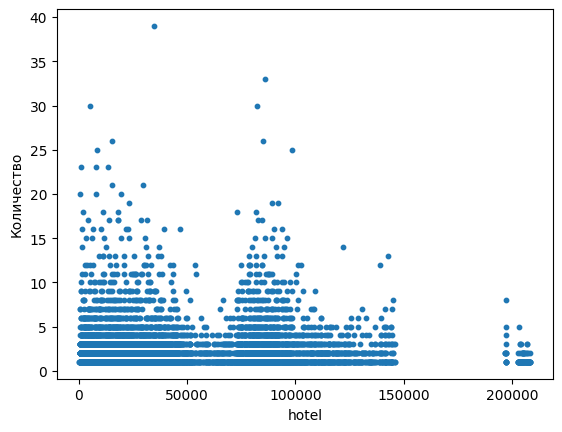

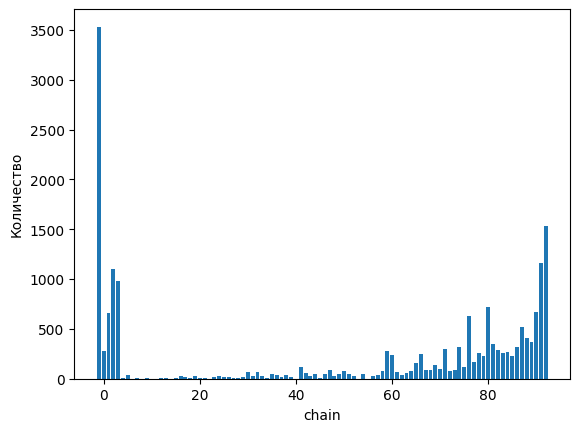

In [7]:
for name, book in zip(['hotel', 'chain'], [images_per_hotel, images_per_chain]):
    plt.xlabel(name)
    plt.ylabel('Количество')
    if name == 'hotel':
        plt.scatter(book.keys(), book.values(), s=10)
    else:
        plt.bar(x=book.keys(), height=book.values())
    plt.show()

**Вывод**: видно что классы несбалансированы и по отелям, и по сетям отелей

### Далее идет работа отдельных моделей, каждая модель в своем jupyter-ноутбуке ###

### Собираем выводы всех моделей в единую базу данных ###

In [8]:
all_data = pd.DataFrame()
size = 13150

In [9]:
color_scores = np.load('scores.npy')[0:size]
hex_colors = np.load('hex_colors.npy')[0:size]
warmness = np.load('warmness.npy')[0:size]
brightness = np.load('brightness.npy')[0:size]
room_classes = np.load('defined_classes.npy')[0:size]
room_captions = np.load('made_captions.npy')[0:size]
hotel_keys = np.load('hotel_keys.npy')
hotel_comms = np.load('hotel_comms.npy')

In [10]:
rooms = np.empty(size, dtype="<U100")
chains = np.empty(size, dtype="<U10")
hotels = np.empty(size, dtype="<U100")
room_comms = np.empty(size, dtype="<U100")

hotels_dict = {hotel_keys[i]: hotel_comms[i] for i in range(len(hotel_keys))}

In [11]:
for i, path in enumerate(img_paths[:size]):
    hotel = int(path.split('\\')[IDX0+2])
    chain = int(path.split('\\')[IDX0+1])
    room = (path.split('\\')[IDX0+4])[:-4]
    
    for arr, val in zip([rooms, chains, hotels], [room, chain, hotel]):
        arr[i] = val
        
    room_comms[i] = hotels_dict[hotel]

In [12]:
hex_colors = [' '.join(colors) for colors in hex_colors]
color_scores = [' '.join(np.asarray(scores, dtype=str)) for scores in color_scores]

In [13]:
columns_to_add = {
    'room_id': rooms,
    'hotel_id': hotels,
    'chain_id': chains,
    'room_class': room_classes,
    'brightness': brightness,
    'warmth': warmness,
    'room_captions': room_captions,
    'hotel_tags': room_comms,
    'hex_colors': hex_colors,
    'color_scores': color_scores,
    'img_location': img_paths[:size],
}

for name in columns_to_add.keys():
    all_data[name] = columns_to_add[name]
    

### Полученная база данных ###

In [14]:
all_data.to_csv('all_data', index=False, sep=';')

**Посмотрим на распределение среди основных классов**

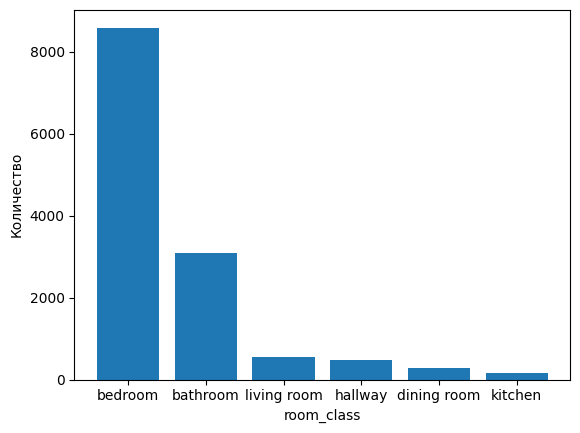

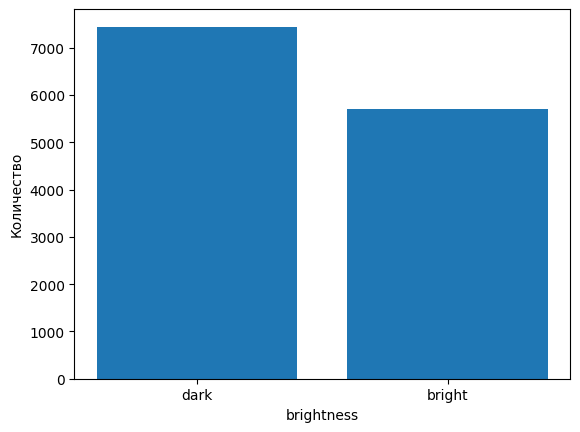

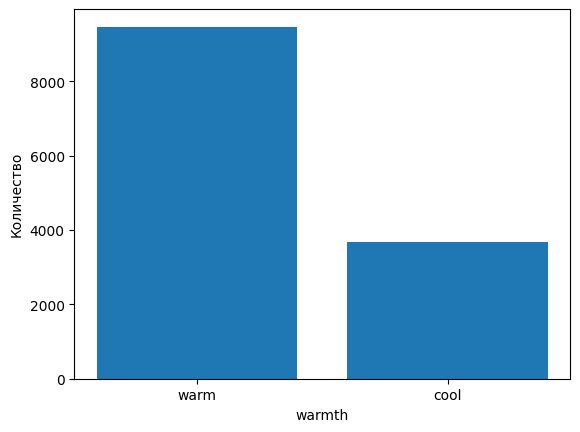

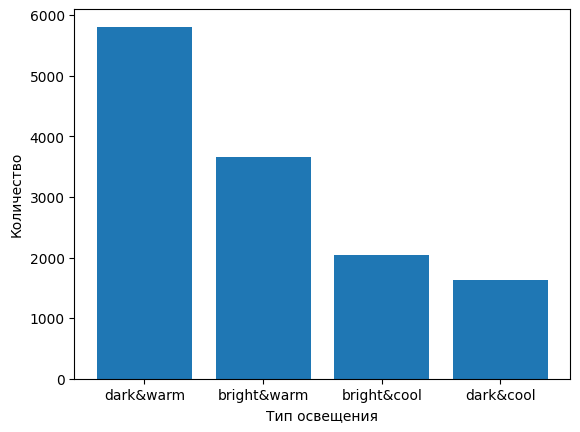

In [15]:
for column in ['room_class', 'brightness', 'warmth']:
    counts = all_data[column].value_counts()
    plt.xlabel(column)
    plt.ylabel('Количество')
    plt.bar(x=counts.index, height=counts.values)
    plt.show()
    
df_lighting = all_data['brightness'] + '&' + all_data['warmth']
counts = df_lighting.value_counts()
plt.xlabel('Тип освещения')
plt.ylabel('Количество')
plt.bar(x=counts.index, height=counts.values)
plt.show()

**Вывод**: классы связанные с освещением сбалансированы (то, что тепло-освещенных комнат в два раза больше - ожидаемо т.к. теплый свет наиболее близок к солнечному освещению). Распределение классов по типу комнаты тоже близко к правде, так как больше всего фотографий с кроватью и ванной комнатой.

Если кластеризовать датасет по тэгам, то число классов и число кластеров не сойдется, потому что число классов (кол-во отелей) >> числа придуманных тэгов (которое равно n_room_type * n_lighting_type = 24)

In [16]:
all_data.head(1)

,room_id,hotel_id,chain_id,room_class,brightness,warmth,room_captions,hotel_tags,hex_colors,color_scores,img_location
0,2652332,1001,-1,bedroom,dark,warm,there is a bed with a red blanket and a white ...,"pillow, brown, blanket, bed",#695f56 #55221d #b6afa2 #f7f5ed #898177 #2b221...,39368 13850 15171 6166 15492 18759 21668 19269...,C:\Users\FMari\TinkoffSirius\images\train\-1\1...


### Функция для получения информации о комнате ###

In [17]:
def get_info(idx):
    """
    функция которая отрисовывает информацию о комнате
    
    :idx: - номер строчки в all_data.csv
    """
    
    data = all_data.iloc[idx]
    pil_image = Image.open(data['img_location'])
    np_image = np.asarray(pil_image)
    title = data['room_id'] + " " + data['hotel_id'] + ' '  \
            + data['chain_id'] + ': ' + data['room_class']
    caption = title + '\n' + data['room_captions']
                
    if data['hotel_tags'] != '':
        caption += '\n' + 'hotel is famous for its' + ' ' + data['hotel_tags']
    
    scores = list(map(int, data['color_scores'].split()))
    hex_colors = data['hex_colors'].split()
    
    plt.figure(figsize = (16, 8))
    plt.text(5, 5, caption, fontsize=20)
    plt.figtext(0.5, -0.05, caption, wrap=True, horizontalalignment='center', fontsize=20)
    plt.subplot(1, 2, 1)
    plt.imshow(np_image)
    plt.subplot(1, 2, 2)
    plt.pie(scores, labels=hex_colors, colors=hex_colors)
    plt.title(data['warmth']+', ' +data['brightness'], fontsize=20)
    plt.show()
    

C:\Users\FMari\AppData\Local\Temp\ipykernel_7556\3928686435.py:24: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1, 2, 1)


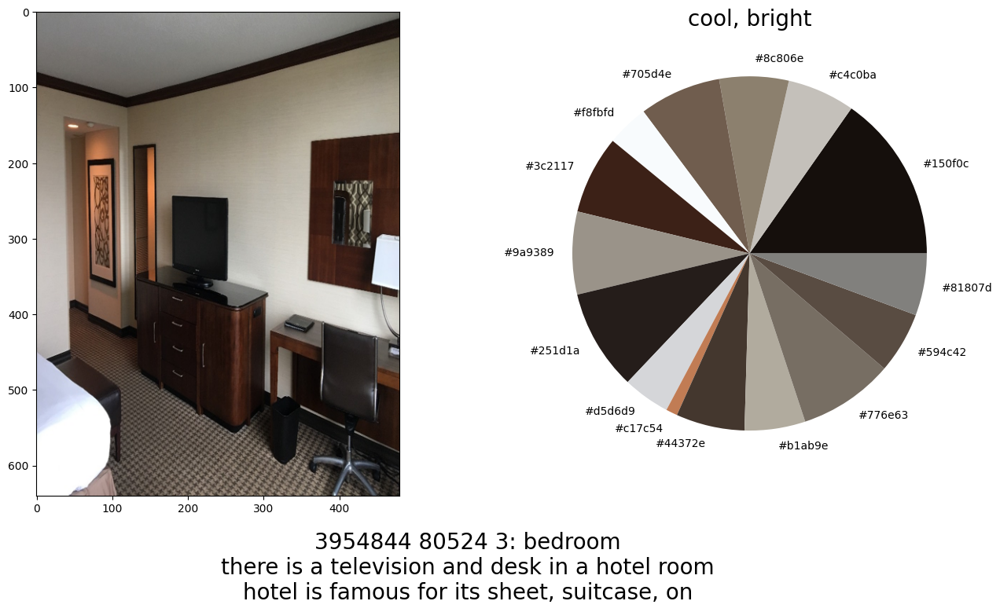

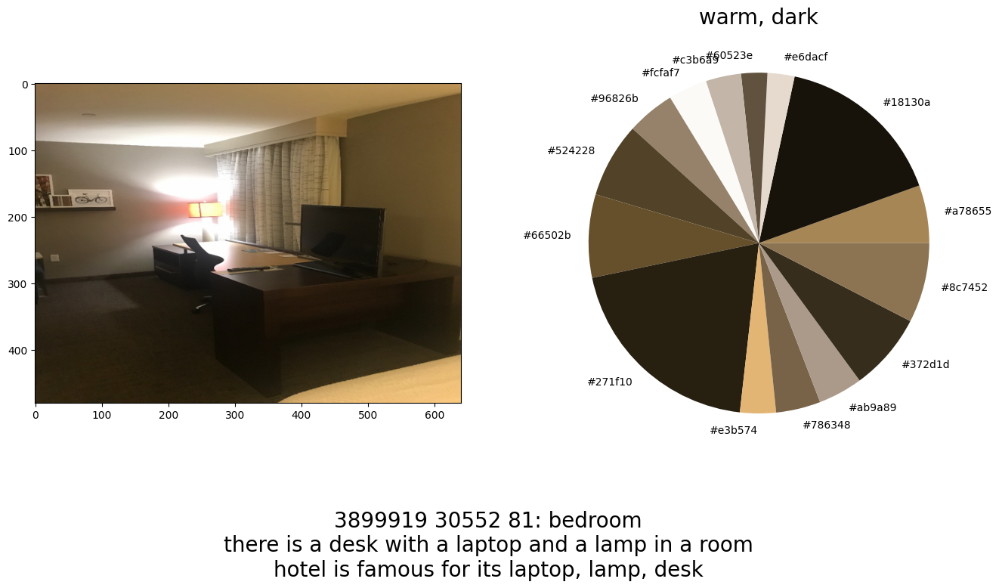

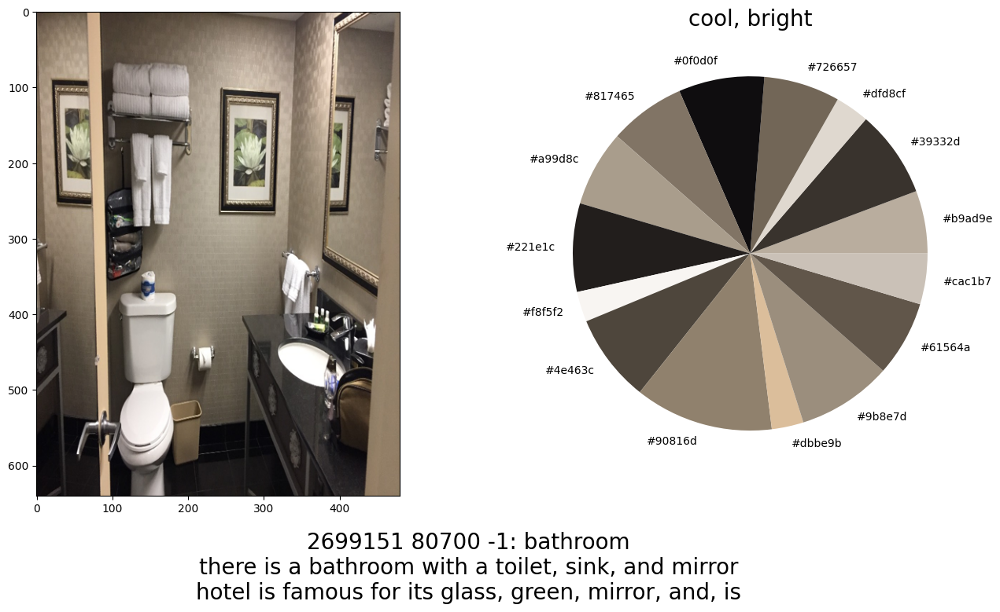

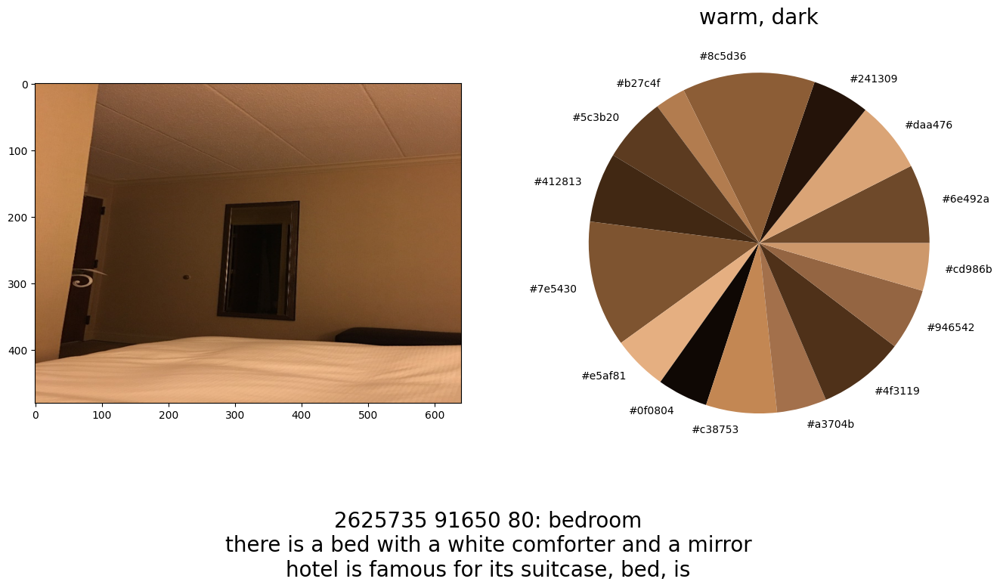

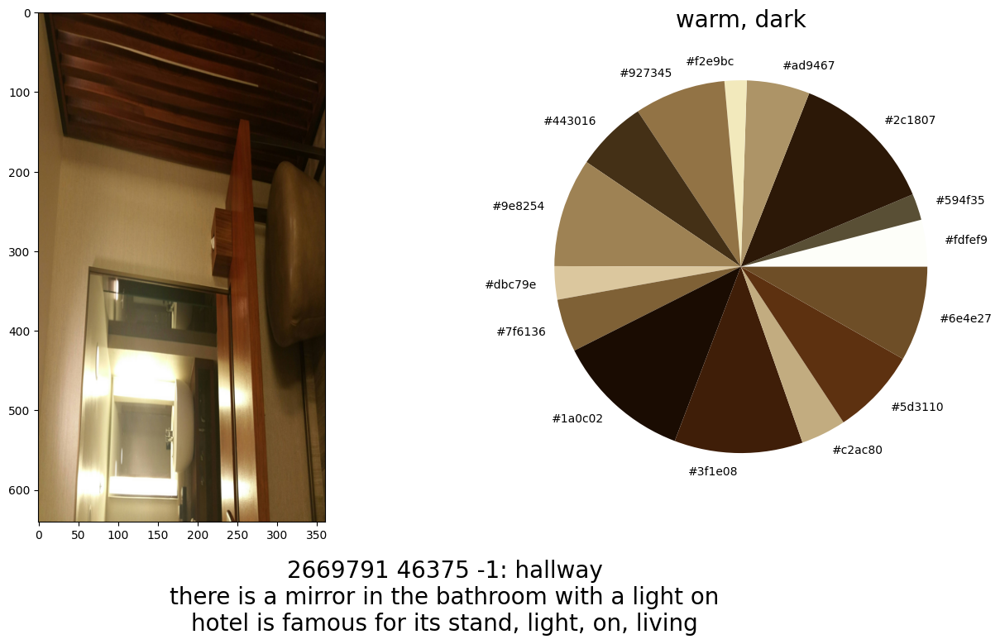

In [18]:
# Пример использования

random_idxs = np.random.choice(size, 5)

for idx in random_idxs:
    get_info(idx)

# Изменение изображения при помощи диффузионной модели #

Создадим выборку из 5-10 фотографий. Постараемся выбрать наиболее разнообразные комнаты (разного типа комнат).

In [19]:
rclasses = ['living room', 'kitchen', 'bathroom', 
            'hallway', 'dining room', 'bedroom']
chosen_paths = []

In [20]:
for clas in rclasses:
    df = all_data[all_data['room_class'] == clas]
    row = np.random.choice(df.index.values, 1)[0]
    random_path = df.loc[row]['img_location']
    chosen_paths.append(random_path)

Посмотрим какие это картинки

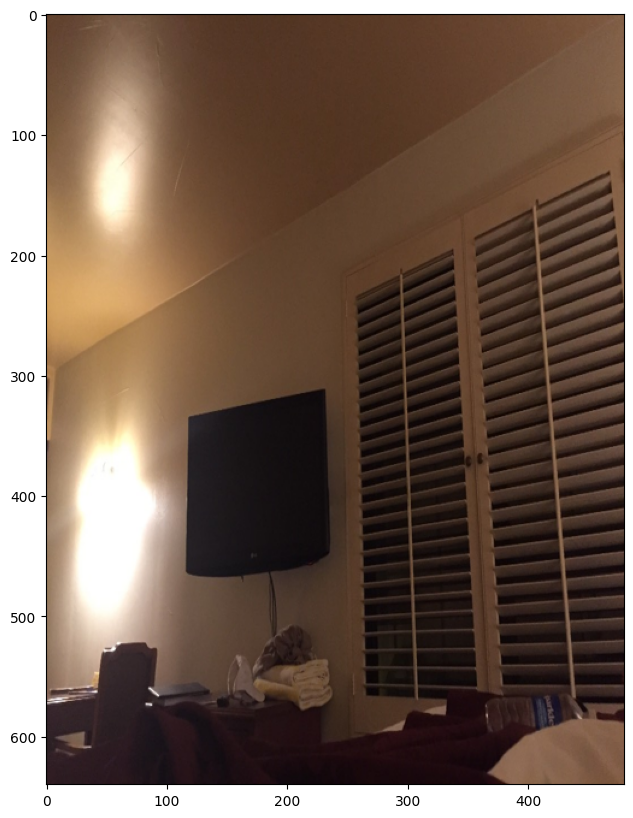

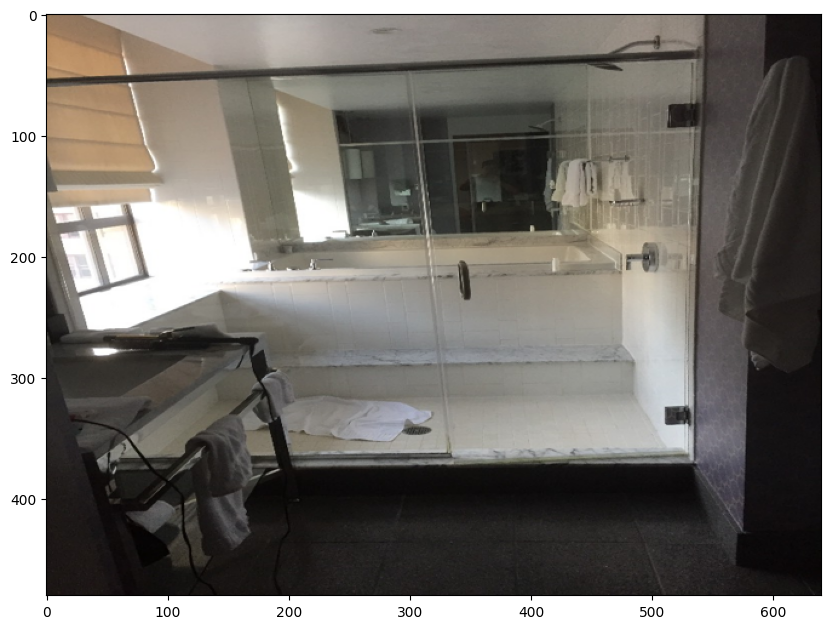

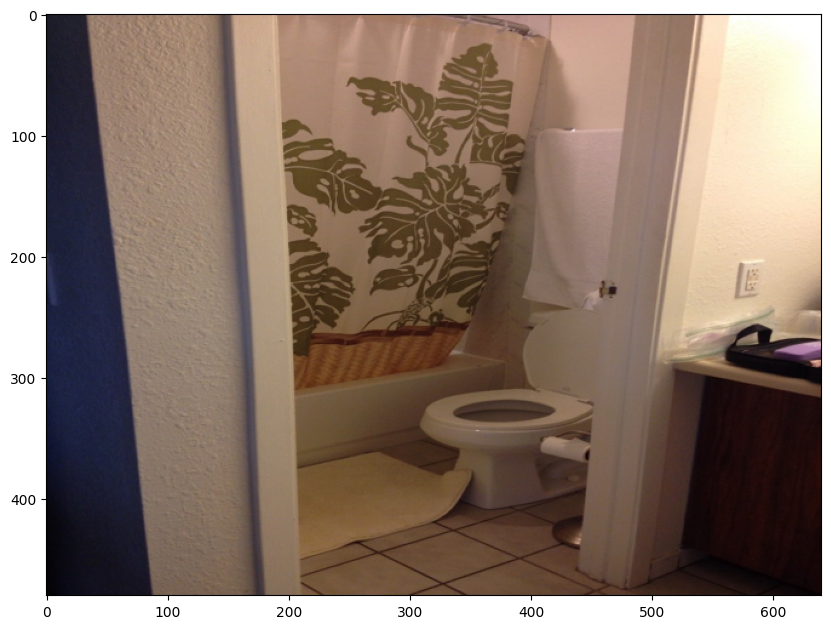

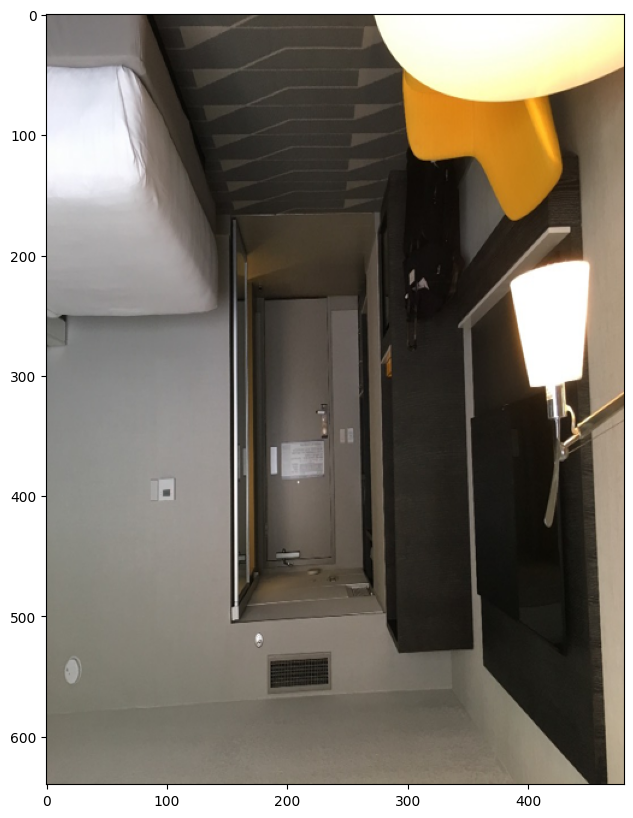

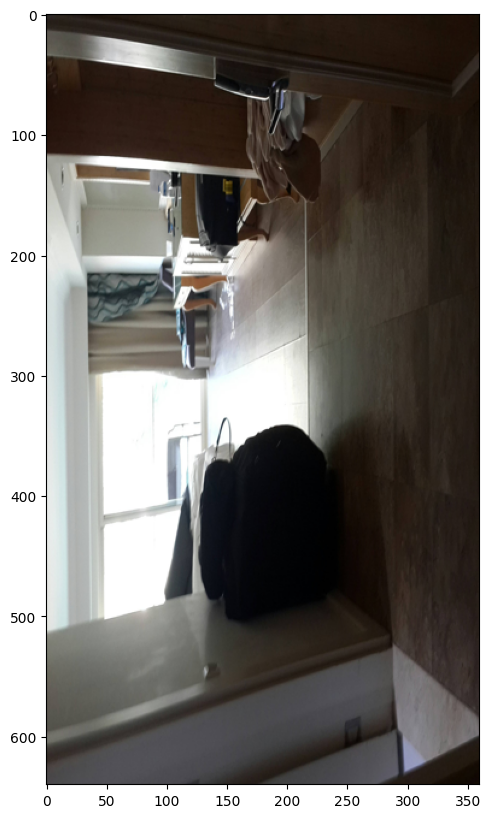

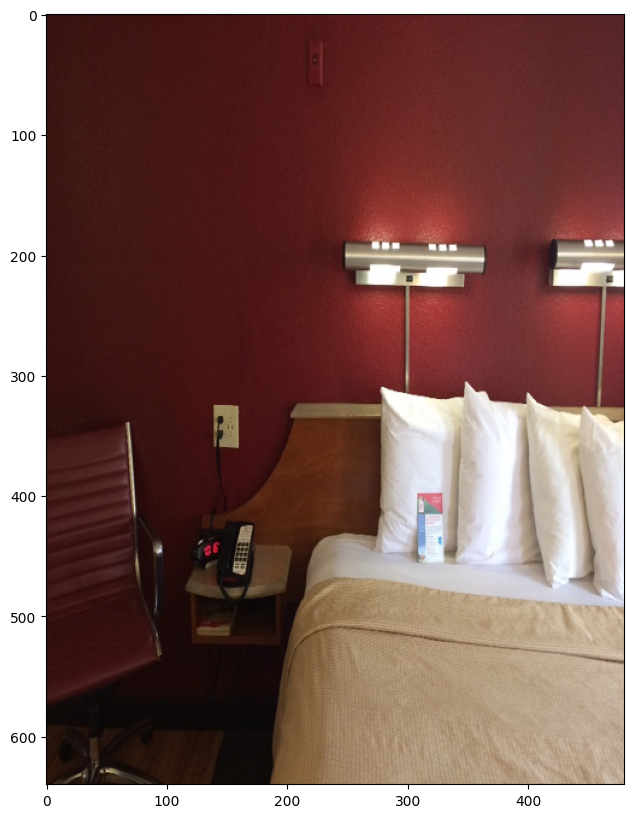

In [33]:
chosen_images = []
for path in chosen_paths:
    image = Image.open(path)
    if image.mode != "RGB":
        image = image.convert("RGB")
    chosen_images.append(image)
    
def plot_images(images, print_text=False, text=None): 
    """
    Функция, которая отрисовывает массив картинок
    
    :images: - список изображений PIL.Image
    :print_text: - выводить ли текст перед картинками
    :text: - какой текст вывести
    """
    
    if print_text:
        print('\n', text, '\n')
    
    for image in images:
        if image.mode != "RGB":
            image = image.convert("RGB")
        
        np_image = np.asarray(image)
        plt.figure(figsize=(10, 10))
        plt.imshow(np_image)
        plt.show()
        
plot_images(chosen_images)

Действительно, довольно разнообразные картинки. Теперь определим модель

In [22]:
class ImageEditing_model():
    
    def __init__(self):
        self.model =  StableDiffusionInstructPix2PixPipeline.from_pretrained(
            "timbrooks/instruct-pix2pix", 
            torch_dtype=torch.float16, 
            safety_checker=None
        )
        self.device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        self.model.to(self.device)
        self.model.scheduler = EulerAncestralDiscreteScheduler.from_config(self.model.scheduler.config)
        
    def predict(self, image, prompt):
        """
        Изменяет картинку по представленному запросу
        Возвращает измененное изображение в формате PIL.Image
        
        :image: - картинка
        :prompt: - текстовый запрос, как изменить картинку
        """

        edited_image = self.model(prompt, image=image, num_inference_steps=9, image_guidance_scale=2).images
        
        return edited_image

In [23]:
ie_model = ImageEditing_model()

unet\diffusion_pytorch_model.safetensors not found


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

Создадим массив запросов с изменениями. Последовательно внесем серию правок.

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]


 add a black suitcase on the floor on the lower part of image 



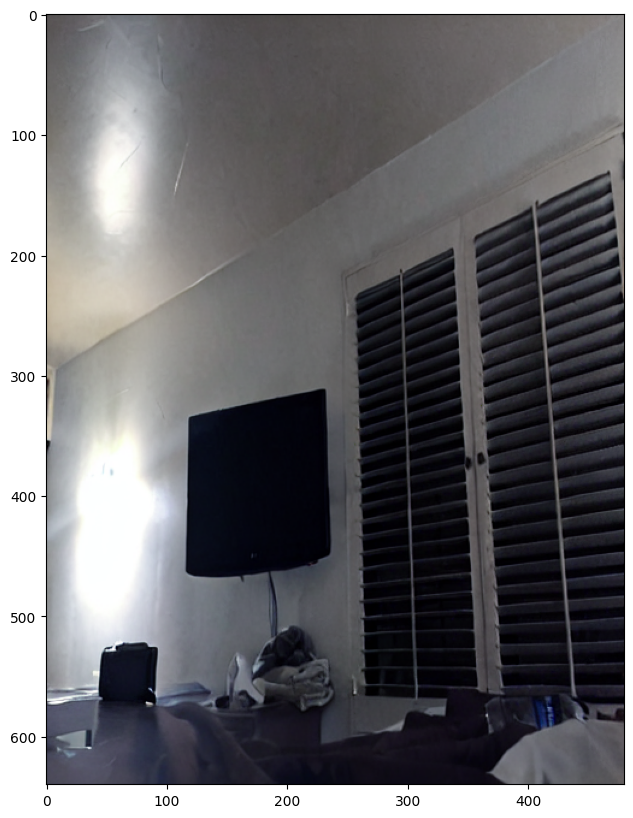

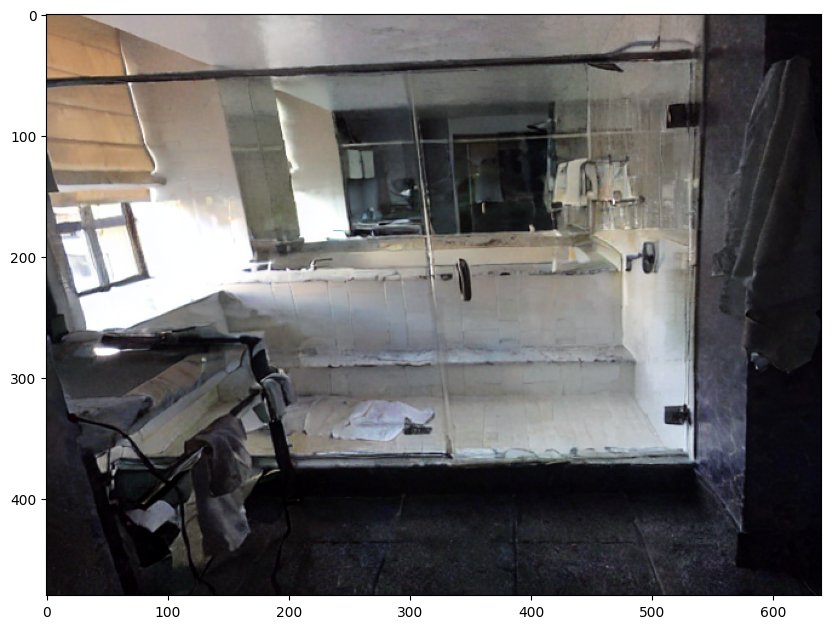

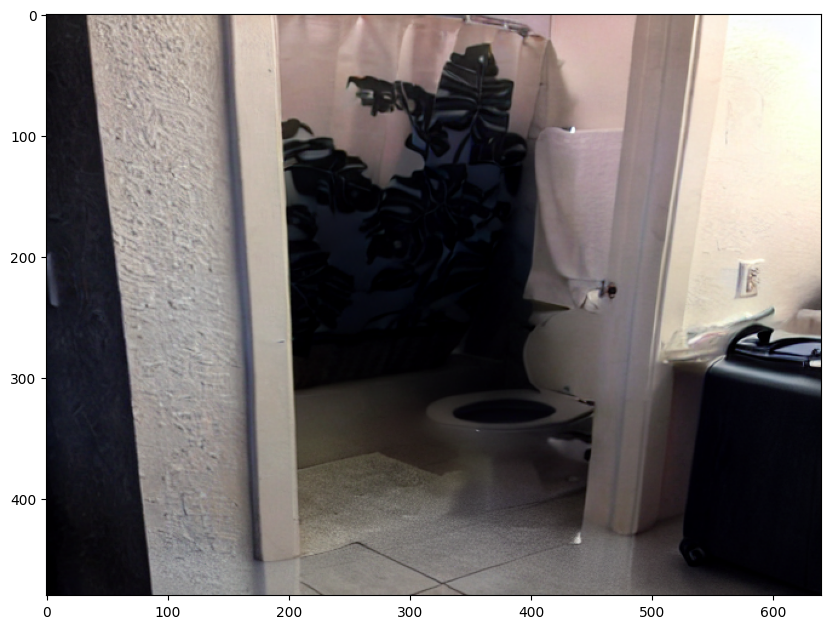

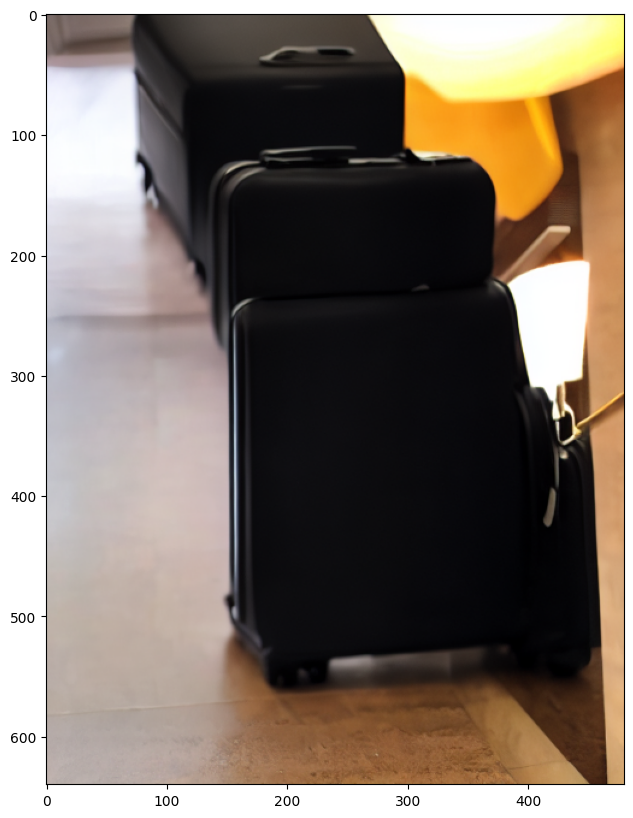

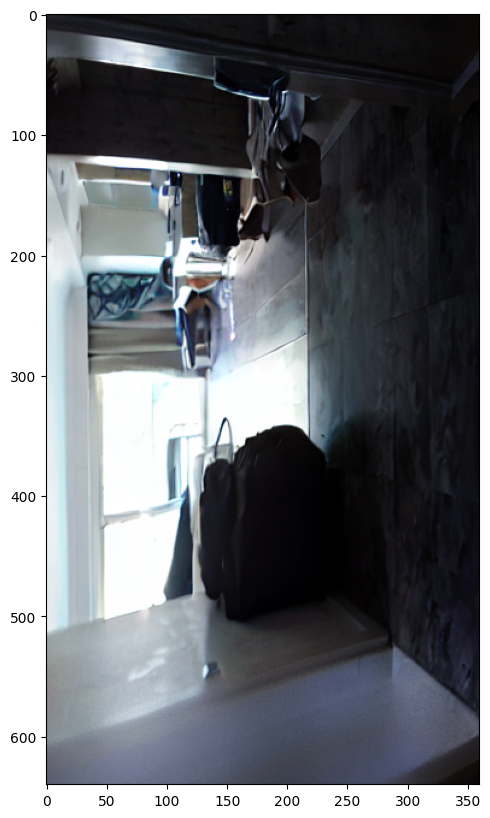

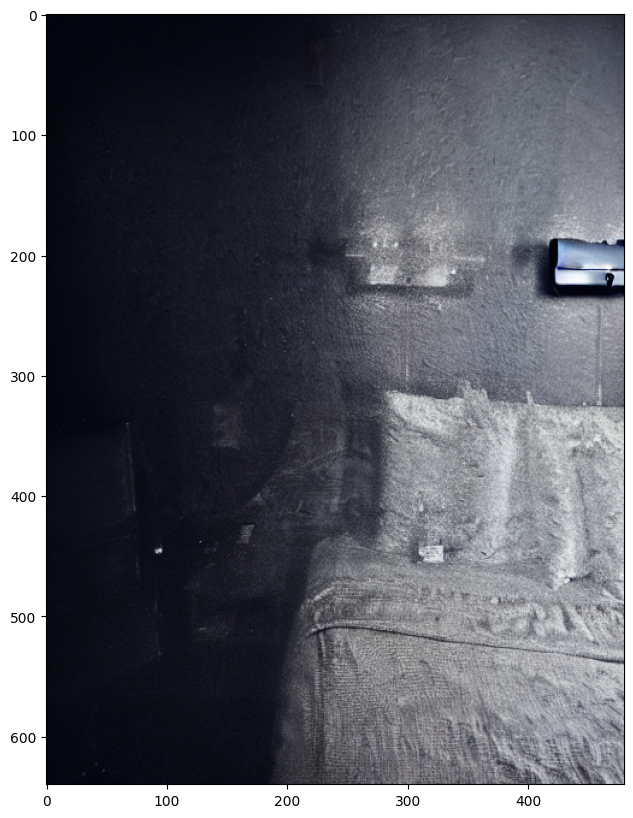

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]


 add a painting on a wall with fireworks 



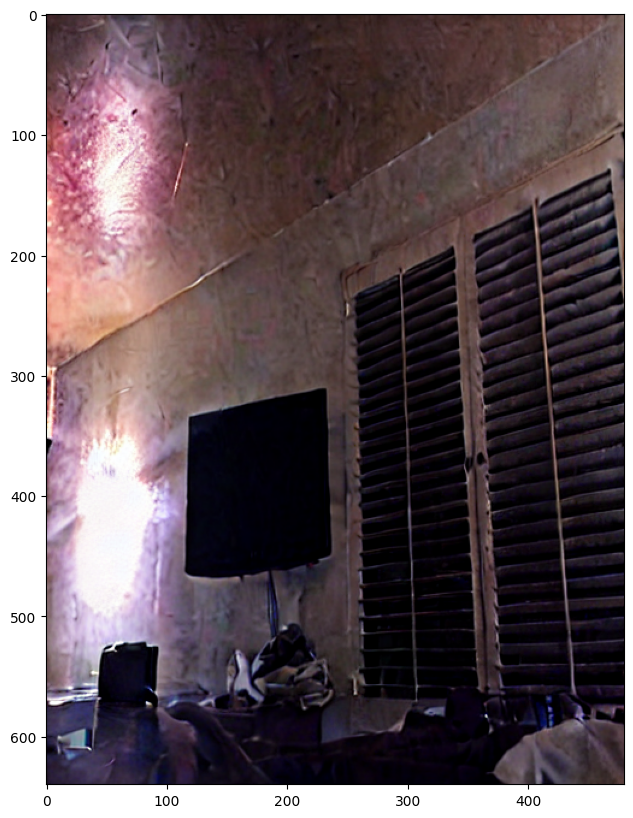

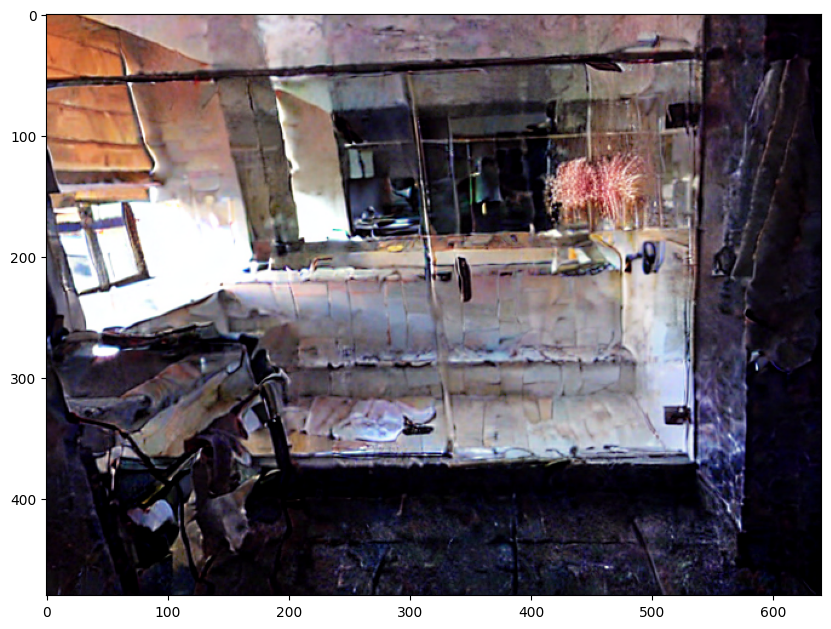

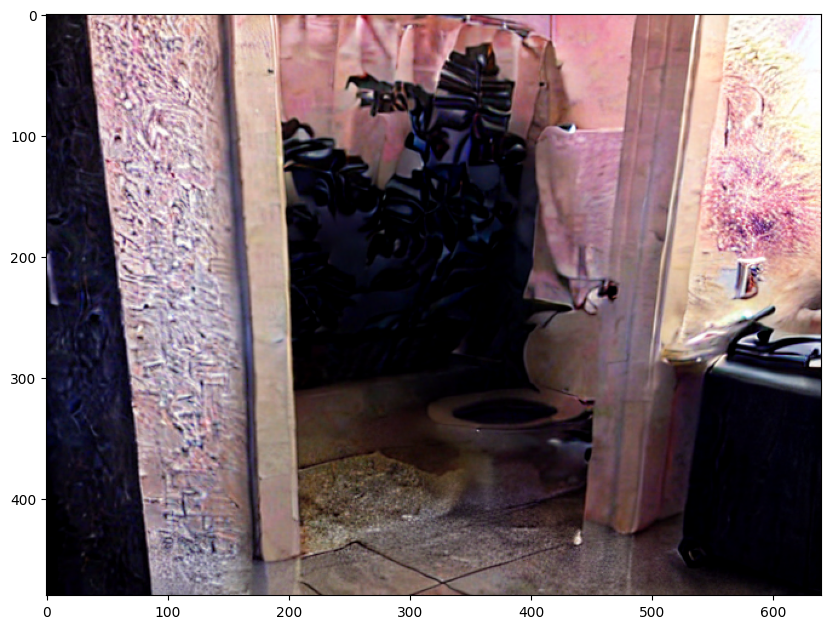

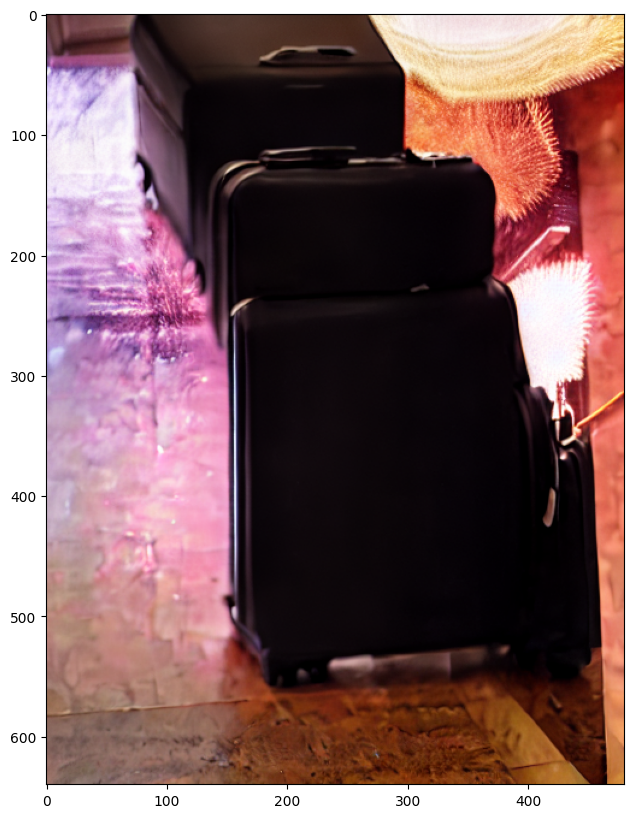

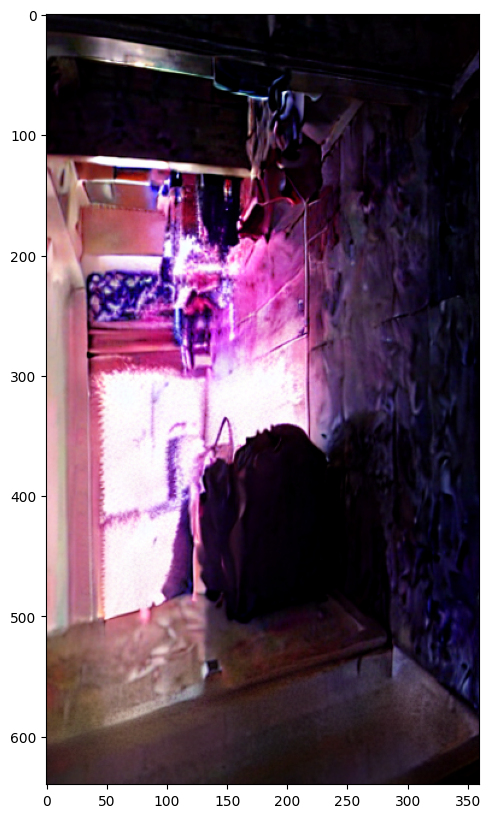

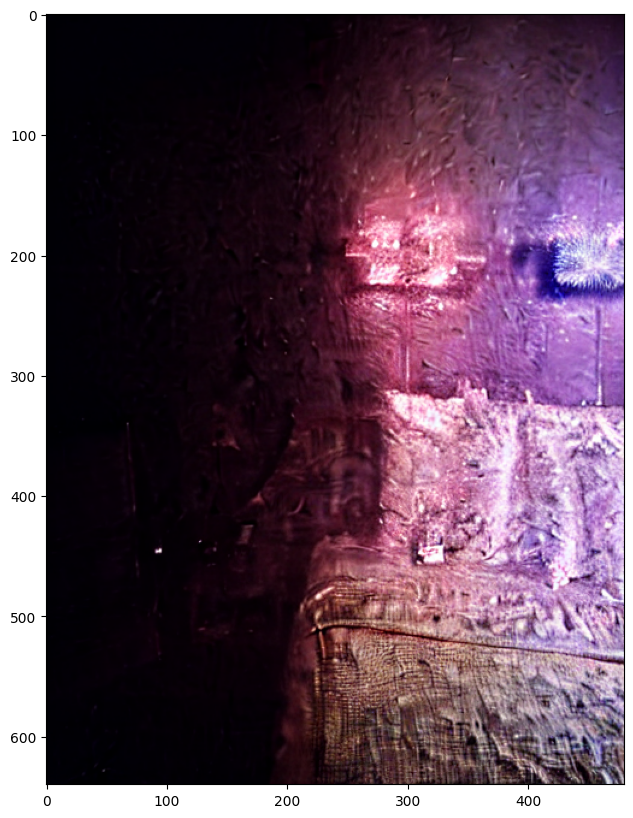

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]


 make the room more bright, add some light to it 



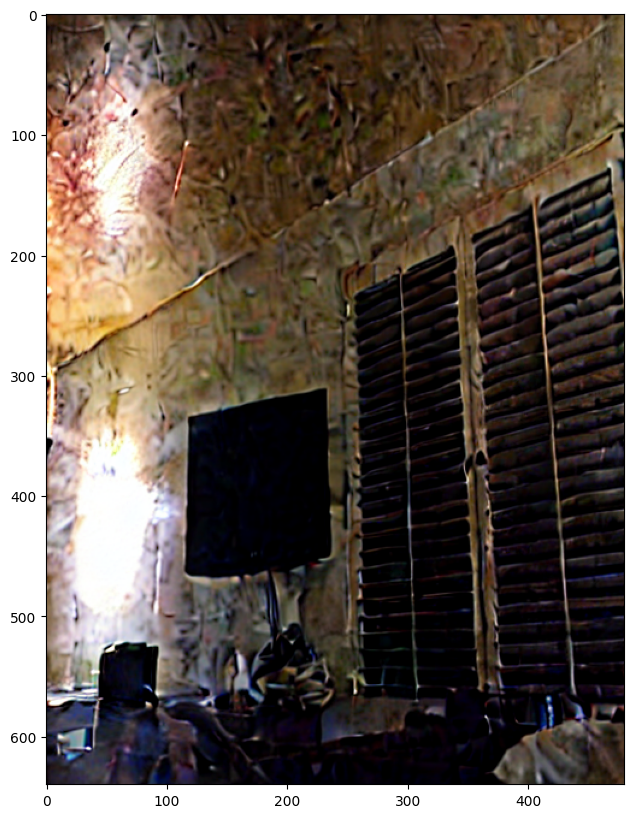

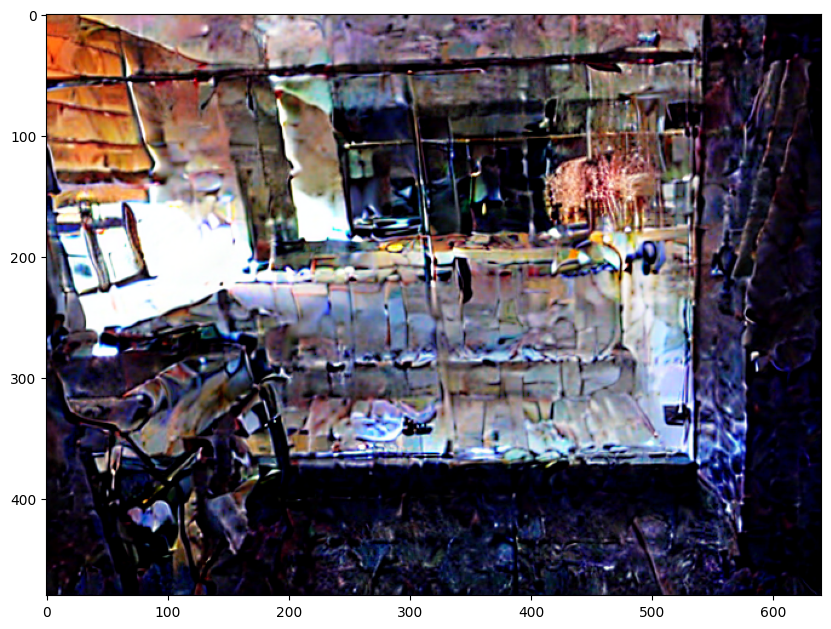

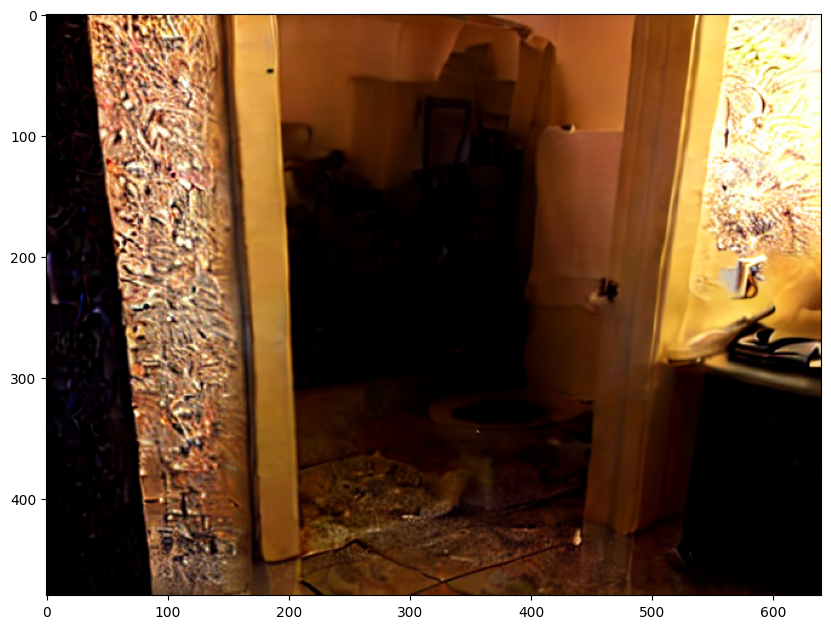

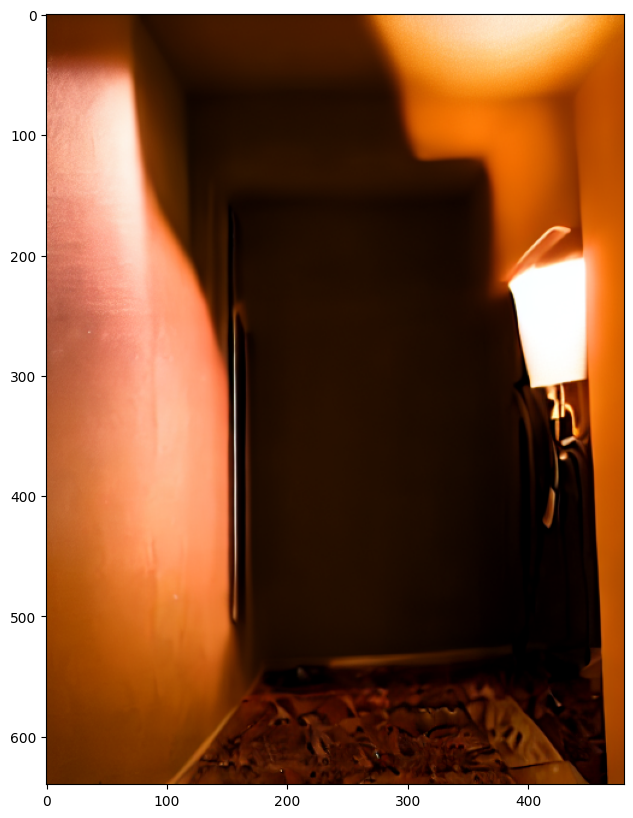

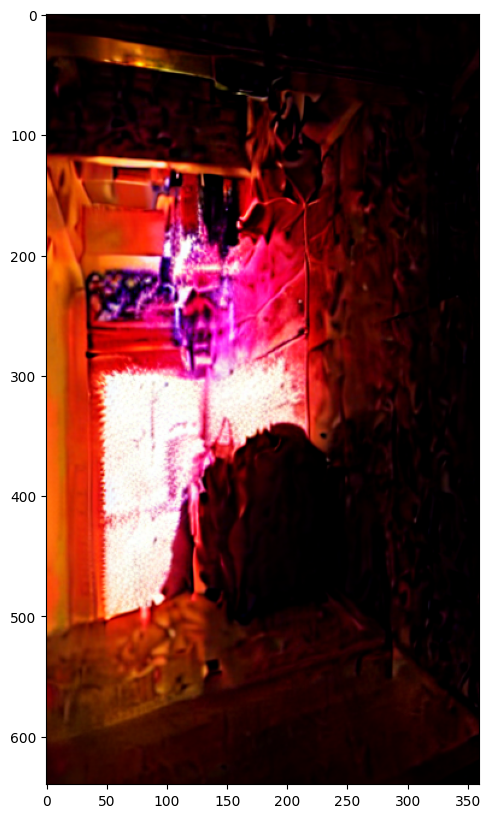

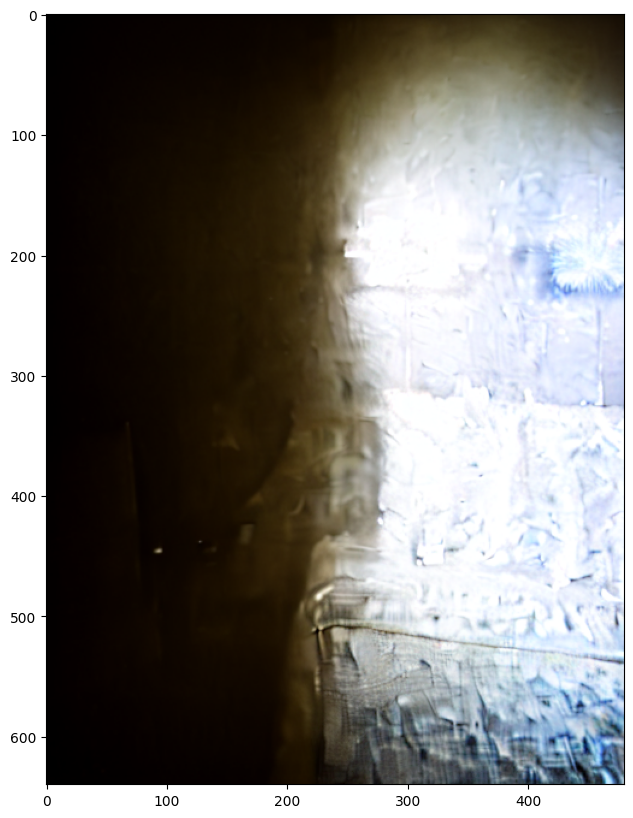

In [46]:
prompts = ['add a black suitcase on the floor on the lower part of image',
           'add a painting on a wall with fireworks',
           'make the room more bright, add some light to it']

new_images = chosen_images

for prompt in prompts:
    tmp_images = []
    for image in new_images:
        im = ie_model.predict(image=image, prompt=prompt)
        tmp_images.append(im)
    new_images = tmp_images
    new_images = [img[0] for img in new_images]
    plot_images(new_images, print_text=True, text=prompt)

**Вывод**: получилось не очень хорошо. Чемодан модель смогла добавить только на одной картинке (и то вся картинка стала чемоданом). При последовательных изменениях становится хуже и хуже. Может быть другие модели Image Editing работают лучше. Я выбрала эту, а не предложенные, т.к. получилось запустить ее на ноутбуке.